In [ ]:
pip install opencv-python


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow


net= cv2.dnn.readNet('/content/yolov3.weights','/content/yolo.cfg/content/yolo.cfg/content/yolo.cfg')

classes=[]

with open ('coco.txt','r') as f:
    classes= f.read().splitlines()

print(classes)

img=cv2.imread("image3.png")
height, width, _ = img.shape

blob=cv2.dnn.blobFromImage(img,1/255,(416,416),(0,0,0),swapRB=True,crop=False)

net.setInput(blob)
output_layers_names = net.getUnconnectedOutLayersNames()
layerOutputs = net.forward(output_layers_names)

boxes = []
confidences = []
class_ids = []

for output in layerOutputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0]*width)
                center_y = int(detection[1]*height)
                w = int(detection[2]*width)
                h = int(detection[3]*height)

                x = int(center_x - w/2)
                y = int(center_y - h/2)

                boxes.append([x, y, w, h])
                confidences.append((float(confidence)))
                class_ids.append(class_id)
  
                boxes.append([x, y, w, h])
                confidences.append((float(confidence)))
                class_ids.append(class_id)

indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.2, 0.4)

font=cv2.FONT_HERSHEY_PLAIN
colors= np.random.uniform(0,255,size=(len(boxes),3))

if len(indexes)>0:
    for i in indexes.flatten():
      x, y, w, h = boxes[i]
      label = str(classes[class_ids[i]])
      confidence = str(round(confidences[i],2))
      color = colors[i]
      cv2.rectangle(img, (x,y), (x+w, y+h), color, 2)
      cv2.putText(img, label + " " + confidence, (x, y+20), font, 2, (255,255,255), 2)




cv2_imshow(img)

cv2.waitKey(0)
cv2.destroyAllWindows()

error: ignored

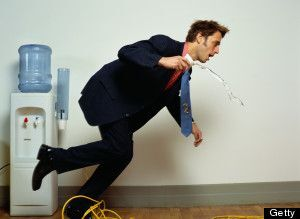

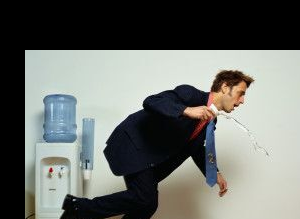

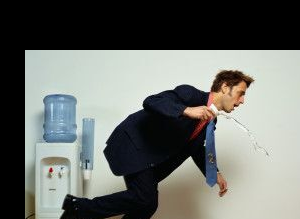

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

image = cv2.imread("image1.jpg")
cv2_imshow(image)
translation_matrix = np.float32([[1, 0, 25], [0, 1, 50]])
shifted = cv2.warpAffine(image, translation_matrix, (image.shape[1], image.shape[0]))

cv2_imshow(shifted)
M = np.float32([[1, 0, -50], [0, 1, -90]])
shifted = cv2.warpAffine(image, translation_matrix, (image.shape[1], image.shape[0]))
cv2_imshow(shifted)

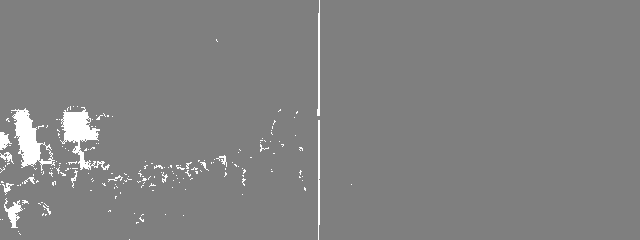

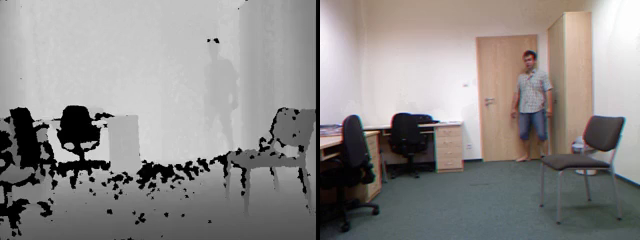

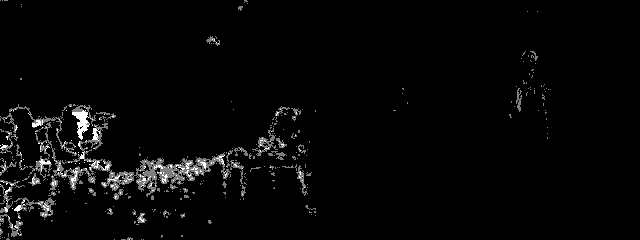

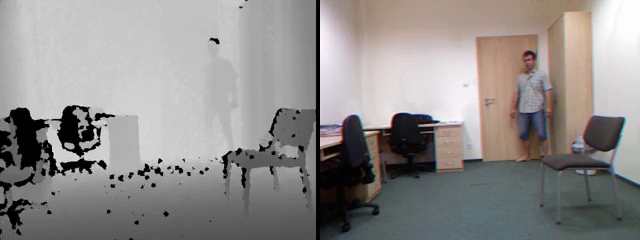

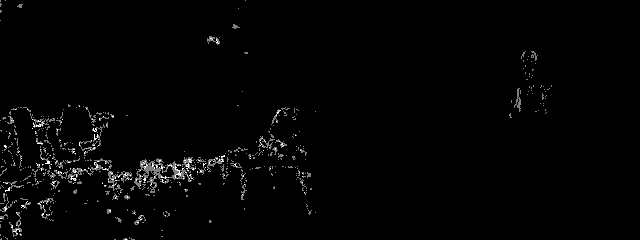

...

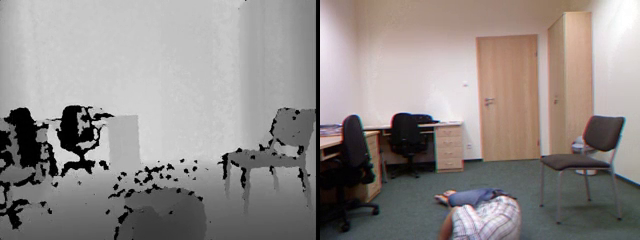

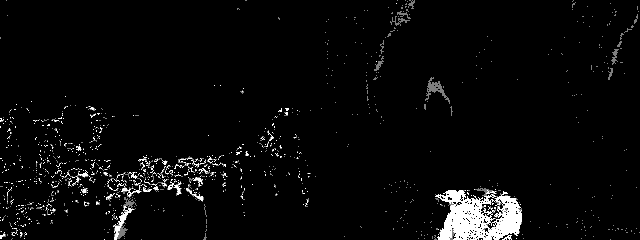

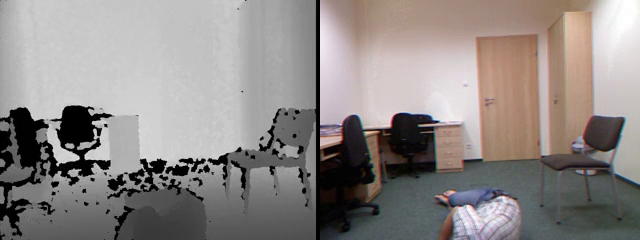

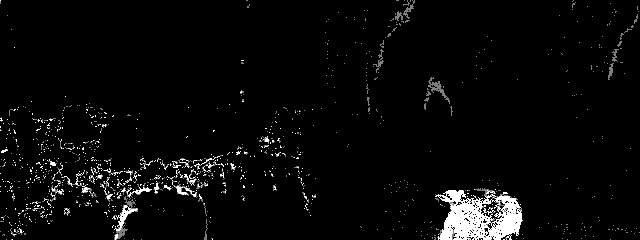

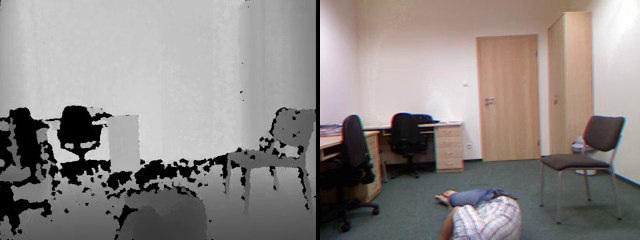

AttributeError: ignored

In [ ]:
# Python code for Background subtraction using OpenCV
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

cap = cv2.VideoCapture('fall-01-cam0.mp4')
fgbg = cv2.createBackgroundSubtractorMOG2()

while(1):
	ret, frame = cap.read()

	fgmask = fgbg.apply(frame)

	cv2_imshow(fgmask)
	cv2_imshow(frame )

	
	k = cv2.waitKey(30) & 0xff
	if k == 27:
		break
	

cap.release()
cv2.destroyAllWindows()
